# Example Poincare BC

In [2]:
import sys
import os

sys.path.insert(0, os.path.abspath("."))
sys.path.append(os.path.abspath("../../"))

from desc.objectives import (
    ObjectiveFunction,
    PoincareLambda,
    ForceBalance,
    RadialForceBalance,
    HelicalForceBalance, 
    Energy
)
from desc.basis import ZernikePolynomial, FourierZernikeBasis,FourierZernike_to_FourierZernike_no_N_modes,FourierZernike_to_PoincareZernikePolynomial
from desc.transform import Transform
from desc.equilibrium import EquilibriaFamily, Equilibrium
from desc.plotting import plot_1d,plot_2d,plot_3d,plot_comparison, plot_section, plot_fsa, plot_surfaces
from desc.optimize import Optimizer
from desc.perturbations import perturb,optimal_perturb
import numpy as np
from desc.geometry import ZernikeRZToroidalSection
%matplotlib inline
from desc.utils import copy_coeffs
import matplotlib.pyplot as plt
from desc.examples import get
from desc.objectives.getters import get_fixed_boundary_constraints
from desc.grid import LinearGrid
from desc.optimize._constraint_wrappers import ProximalProjection

The Poincare BC let's you specify a toroidal cross-section at $\zeta=0$ as your fixed boundary for an equilibrium solve, instead of the $\rho=1$ LCFS.

In [3]:
def get_eq_poin(eq):
    Rb_lmn, Rb_basis = FourierZernike_to_PoincareZernikePolynomial(eq.R_lmn, eq.R_basis)
    Zb_lmn, Zb_basis = FourierZernike_to_PoincareZernikePolynomial(eq.Z_lmn, eq.Z_basis)
    Lb_lmn, Lb_basis = FourierZernike_to_FourierZernike_no_N_modes(eq.L_lmn, eq.L_basis)

    surf = ZernikeRZToroidalSection(
        R_lmn=Rb_lmn,
        modes_R=Rb_basis.modes[:, :2].astype(int),
        Z_lmn=Zb_lmn,
        modes_Z=Zb_basis.modes[:, :2].astype(int),
        spectral_indexing=eq._spectral_indexing,
    )
    eq_poin = Equilibrium(surface=surf,
                 pressure=eq.pressure,
                 iota=eq.iota,
                 Psi=eq.Psi, # flux (in Webers) within the last closed flux surface
                 NFP=eq.NFP, # number of field periods
                 L=eq.L, # radial spectral resolution
                 M=eq.M, # poloidal spectral resolution
                 N=eq.N, # toroidal spectral resolution 
                 L_grid=eq.L_grid, # real space radial resolution, slightly oversampled
                 M_grid=eq.M_grid, # real space poloidal resolution, slightly oversampled
                 N_grid=eq.N_grid, # real space toroidal resolution
                 sym=True, # explicitly enforce stellarator symmetry
                 bdry_mode='poincare',
                 spectral_indexing=eq._spectral_indexing,  
                )
    eq_poin.L_lmn = (
        Lb_lmn  # initialize the poincare eq with the lambda of the original eq
    )
    
    return eq_poin

In [4]:
def get_eq_poin_no_lambda(eq):

    Rb_lmn, Rb_basis = FourierZernike_to_PoincareZernikePolynomial(eq.R_lmn, eq.R_basis)
    Zb_lmn, Zb_basis = FourierZernike_to_PoincareZernikePolynomial(eq.Z_lmn, eq.Z_basis)
    Lb_lmn, Lb_basis = FourierZernike_to_FourierZernike_no_N_modes(eq.L_lmn, eq.L_basis)

    surf = ZernikeRZToroidalSection(
        R_lmn=Rb_lmn,
        modes_R=Rb_basis.modes[:, :2].astype(int),
        Z_lmn=Zb_lmn,
        modes_Z=Zb_basis.modes[:, :2].astype(int),
        spectral_indexing=eq._spectral_indexing,
    )
    eq_poin = Equilibrium(surface=surf,
                 pressure=eq.pressure,
                 iota=eq.iota,
                 Psi=eq.Psi, # flux (in Webers) within the last closed flux surface
                 NFP=eq.NFP, # number of field periods
                 L=eq.L, # radial spectral resolution
                 M=eq.M, # poloidal spectral resolution
                 N=eq.N, # toroidal spectral resolution 
                 L_grid=eq.L_grid, # real space radial resolution, slightly oversampled
                 M_grid=eq.M_grid, # real space poloidal resolution, slightly oversampled
                 N_grid=eq.N_grid, # real space toroidal resolution
                 sym=True, # explicitly enforce stellarator symmetry
                 bdry_mode='poincare'
                )
    
    return eq_poin#,L_lmn,L_basis

(<Figure size 1152.57x960.473 with 6 Axes>,
 array([<Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.000$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>,
        <Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.167$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>,
        <Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.333$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>,
        <Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.500$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>,
        <Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.667$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>,
        <Axes: title={'center': '$\\phi \\cdot N_{FP}/2\\pi = 0.833$'}, xlabel='$R ~(\\mathrm{m})$', ylabel='$Z ~(\\mathrm{m})$'>],
       dtype=object))

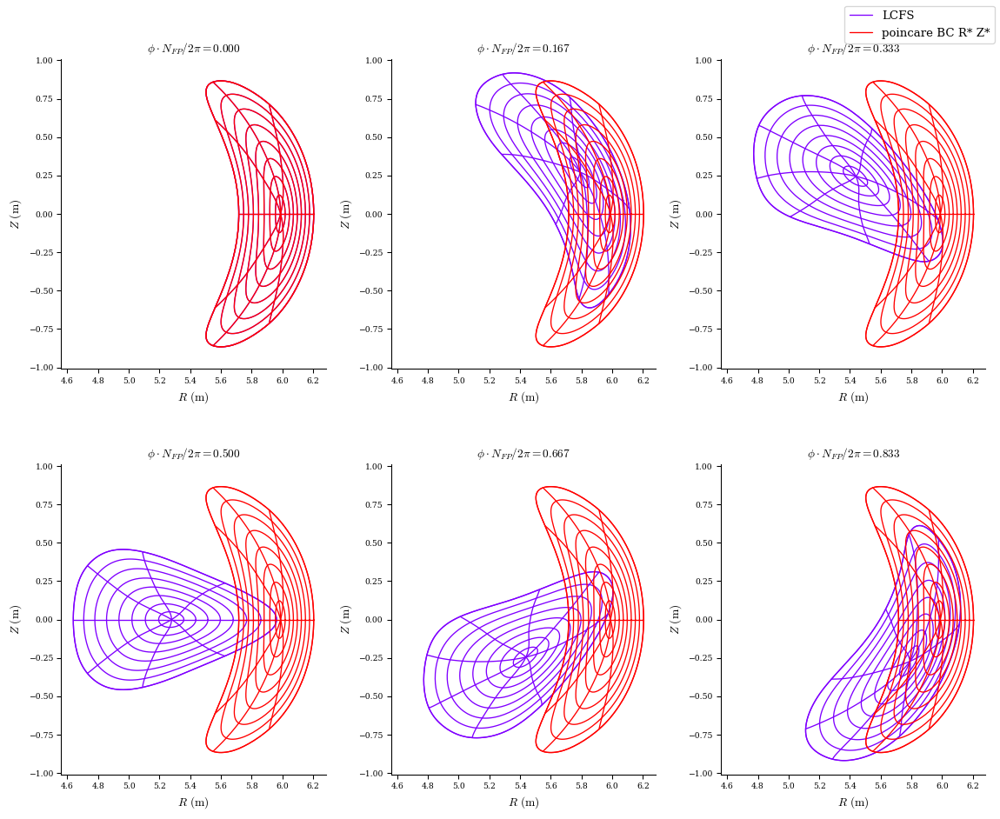

In [5]:
# LCFS took 1590 free parameters
# Poincare only took 1014, so takes LESS for SAME OVERALL RESOLUTION
# and this easy case works R*,Z* and R,Z
# eq = EquilibriaFamily.load(load_from='HELIOTRON/HELIOTRON_output.h5')[-1]
# eq = EquilibriaFamily.load(load_from='../examples/DESC/HELIOTRON_ansi_less_output.h5')[-1]
eq = get("W7-X")

# eq_poin = Equilibrium.load(load_from='HELIOTRON_poin_cont_M_N_2_M_6.h5')
eq_poin = get_eq_poin(eq)
# eq_poin = get_eq_poin_no_lambda(eq)
plot_comparison(eqs=[eq,eq_poin],labels=['LCFS','poincare BC R* Z*'])


In [6]:
# np.set_printoptions(threshold=np.inf)
# print(eq_poin.R_basis.modes)
new_coef = np.empty([(eq_poin.R_basis.modes).shape[0], (eq_poin.R_basis.modes).shape[1]+1])
new_coef[:,:3] = eq_poin.R_basis.modes
new_coef[:,3] = eq_poin.R_lmn
for row in new_coef:
    print('{:}{:<{w}.0f} {:}{:<{w}.0f} {:}{:<{w}.0f} {:}{:>{w2}.8f}'.format('l = ', row[0], 'm = ', row[1], 'n = ', row[2], 'R_lmn = ', row[3],w=4, w2=12))

l = 1    m = -1   n = -12  R_lmn =   0.00000000
l = 2    m = -2   n = -12  R_lmn =   0.00000000
l = 3    m = -3   n = -12  R_lmn =   0.00000000
l = 3    m = -1   n = -12  R_lmn =   0.00000000
l = 4    m = -4   n = -12  R_lmn =   0.00000000
l = 4    m = -2   n = -12  R_lmn =   0.00000000
l = 5    m = -5   n = -12  R_lmn =   0.00000000
l = 5    m = -3   n = -12  R_lmn =   0.00000000
l = 5    m = -1   n = -12  R_lmn =   0.00000000
l = 6    m = -6   n = -12  R_lmn =   0.00000000
l = 6    m = -4   n = -12  R_lmn =   0.00000000
l = 6    m = -2   n = -12  R_lmn =   0.00000000
l = 7    m = -7   n = -12  R_lmn =   0.00000000
l = 7    m = -5   n = -12  R_lmn =   0.00000000
l = 7    m = -3   n = -12  R_lmn =   0.00000000
l = 7    m = -1   n = -12  R_lmn =   0.00000000
l = 8    m = -8   n = -12  R_lmn =   0.00000000
l = 8    m = -6   n = -12  R_lmn =   0.00000000
l = 8    m = -4   n = -12  R_lmn =   0.00000000
l = 8    m = -2   n = -12  R_lmn =   0.00000000
l = 9    m = -9   n = -12  R_lmn =   0.0

In [7]:
plot_3d(eq,"|B|")

In [8]:
plot_3d(eq_poin,"|B|")

In [ ]:
new_coef = np.empty([(eq_poin.R_basis.modes).shape[0], (eq_poin.R_basis.modes).shape[1]+1])
new_coef[:,:3] = eq_poin.R_basis.modes
new_coef[:,3] = eq_poin.R_lmn
for row in new_coef:
    print('{:}{:<{w}.0f} {:}{:<{w}.0f} {:}{:<{w}.0f} {:}{:>{w2}.8f}'.format('l = ', row[0], 'm = ', row[1], 'n = ', row[2], 'L_lmn = ', row[3],w=4, w2=12))

In [ ]:
# plot_surfaces(eq_poin)
# print(eq_poin.N)
# print(eq.N)
new_coef_eq = np.empty([(eq.R_basis.modes).shape[0], (eq.R_basis.modes).shape[1]+1])
new_coef_eq[:,:3] = eq.R_basis.modes
new_coef_eq[:,3] = eq.R_lmn
for row in new_coef_eq:
    print('{:}{:<{w}.0f} {:}{:<{w}.0f} {:}{:<{w}.0f} {:}{:>{w2}.8f}'.format('l = ', row[0], 'm = ', row[1], 'n = ', row[2], 'L_lmn = ', row[3],w=4, w2=12))

In [ ]:
# ran once after above cell and upped grid res to 4.25 * N
Lgrid_orig = eq_poin.L_grid
Mgrid_orig = eq_poin.M_grid

for n in range(3,4):
    # eq_poin.change_resolution(L_orig,M_orig,n) # must be certain bases are the same before assigning eq.X_lmn
    eq_poin.change_resolution(M_grid=Mgrid_orig+2,L_grid=Lgrid_orig+2)
    eq_poin.N_grid=round(5.25*n)
    constraints = get_fixed_boundary_constraints(eq_poin,poincare_lambda=True)

    objective = ObjectiveFunction(ForceBalance(eq_poin))
    eq_poin.solve(verbose=3, ftol=1e-4,objective=objective,constraints=constraints,maxiter=20,xtol=1e-8)
    plot_comparison(eqs=[eq,eq_poin],labels=['LCFS',f'poincare BC R* Z* N={n}'])
    # plt.savefig(f'HELIOTRON_poin_cont_M_N_{n}_M_6_surface_compare.png')
    # eq_poin.save(f'HELIOTRON_poin_cont_M_N_{n}_M_6.h5')

In [ ]:
# ran once after above cell and upped grid res to 4.25 * N
Lgrid_orig = eq_poin.L_grid
Mgrid_orig = eq_poin.M_grid

for n in range(4,5):
    eq_poin.change_resolution(eq_poin.L,eq_poin.M,n) # must be certain bases are the same before assigning eq.X_lmn
    eq_poin.change_resolution(M_grid=Mgrid_orig+2,L_grid=Lgrid_orig+2)
    eq_poin.N_grid=round(4.25*n)
    constraints = get_fixed_boundary_constraints(eq_poin,poincare_lambda=True)

    objective = ObjectiveFunction(ForceBalance(eq_poin))
    eq_poin.solve(verbose=3, ftol=1e-4,objective=objective,constraints=constraints,maxiter=30,xtol=1e-8)
    plot_comparison(eqs=[eq,eq_poin],labels=['LCFS',f'poincare BC R* Z* N={n}'])
    # plt.savefig(f'HELIOTRON_poin_cont_M_N_{n}_M_6_surface_compare.png')
    # eq_poin.save(f'HELIOTRON_poin_cont_M_N_{n}_M_6.h5')

In [ ]:
plot_section(eq,'|F|',log=True,norm_F=True)
plot_section(eq_poin,'|F|',log=True,norm_F=True)

In [ ]:
fig,ax = plot_fsa(eq,'|F|',label='orig lcfs',norm_F=True)
fig,ax = plot_fsa(eq_poin,'|F|',label='poincare',ax=ax,norm_F=True)
ax.legend()

In [ ]:
# ake plot of vol avg err vs res
from desc.grid import QuadratureGrid
import desc.io
factor=3.2

Fs=[]
ns=[]
for n in range(1,7):
    # try:
    eq_poin=desc.io.load(f'HELIOTRON/HELIO_weaker_N{n}_out.h5')
    print(eq_poin)
    ns.append(n)
    grid_poin = QuadratureGrid(L=round(eq_poin.L*factor),M=round(eq_poin.M*factor),N=round(eq_poin.N*factor))
    F_poin = eq_poin.compute(grid=grid_poin,name='<|F|>_vol')['<|F|>_vol']
    Fs.append(F_poin)
    # except:
    #     print(f'no file found for N={n}')
        

In [ ]:
import matplotlib.pyplot as plt
plt.figure()
plt.scatter(ns,Fs)
plt.yscale('log')
plt.xlabel('Toroidal Resolution N')
plt.ylabel('Volume Averaged F error [N/m^3]')

# Same as above but dont give lambda, only R and Z

In [ ]:
eq = EquilibriaFamily.load(load_from='HELIOTRON/HELIO_weaker_output.h5')[-1]
eq_poin = get_eq_poin_no_lambda(eq)
plot_comparison(eqs=[eq,eq_poin],labels=['LCFS','poincare BC R Z'])

In [ ]:
for n in range(1,4):
    eq_poin.change_resolution(eq_poin.L,eq_poin.M,n) # must be certain bases are the same before assigning eq.X_lmn
    eq_poin.N_grid=3*n
    constraints = get_fixed_boundary_constraints()

    objective = ObjectiveFunction(ForceBalance(eq_poin))
    eq_poin.solve(verbose=3, ftol=1e-5,objective=objective,constraints=constraints,maxiter=200,xtol=1e-6);
    plot_comparison(eqs=[eq,eq_poin],labels=['LCFS',f'poincare BC R Z N={n}'])

# HELIOTRON

In [ ]:
eq = EquilibriaFamily.load(load_from='HELIOTRON/HELIOTRON_output.h5')[-1]
eq_poin = get_eq_poin(eq)
plot_comparison(eqs=[eq,eq_poin],labels=['LCFS','poincare BC R* Z*'])

In [ ]:
for n in range(2,9):
    eq_poin.change_resolution(eq_poin.L,eq_poin.M,n) # must be certain bases are the same before assigning eq.X_lmn
    eq_poin.N_grid=int(2*n)
    constraints = get_fixed_boundary_constraints() + (PoincareLambda(),)

    objective = ObjectiveFunction(ForceBalance(eq_poin))
    eq_poin.solve(verbose=3, ftol=1e-3,objective=objective,constraints=constraints,maxiter=200,xtol=1e-6)#,options={"max_trust_radius":1e-1,"initial_trust_radius":2e-2});
    plot_comparison(eqs=[eq,eq_poin],labels=['LCFS',f'poincare BC R* Z* N={n}'])

In [ ]:
eq.save('HELIOTRON_poincare_lambda_N6.h5')

In [ ]:
eq.compute('<|F|>_vol')

In [ ]:
eq = EquilibriaFamily.load(load_from='HELIOTRON/HELIOTRON_output.h5')[-1]
eq_poin = get_eq_poin_no_lambda(eq)
plot_comparison(eqs=[eq,eq_poin],labels=['LCFS','poincare BC R Z'])

In [ ]:
ftols = [1e-3,1e-3,1e-4]
for n in range(1,4):
    eq_poin.change_resolution(L_grid = eq.L_grid+n,M_grid=eq.M_grid+n,L=eq_poin.L,M=eq_poin.M,N=n) 
    eq_poin.N_grid=round(3.5*n)
    constraints = get_fixed_boundary_constraints()

    objective = ObjectiveFunction(ForceBalance(eq_poin))
    eq_poin.solve(verbose=3, ftol=ftols[n-1],objective=objective,constraints=constraints,maxiter=200,xtol=1e-6);
    plot_comparison(eqs=[eq,eq_poin],labels=['LCFS',f'poincare BC R Z N={n}'])
eq_poin.save("heliotron_R_Z_no_L_inc_grid_res_output.h5")

In [ ]:
for n in range(4,6):
    eq_poin.change_resolution(eq_poin.L,eq_poin.M,n) # must be certain bases are the same before assigning eq.X_lmn
    eq_poin.N_grid=3*n
    constraints = get_fixed_boundary_constraints()

    objective = ObjectiveFunction(ForceBalance(eq_poin))
    eq_poin.solve(verbose=3, ftol=1e-5,objective=objective,constraints=constraints,maxiter=300,xtol=1e-6);
    plot_comparison(eqs=[eq,eq_poin],labels=['LCFS',f'poincare BC R Z N={n}'])

# Same but do W7X

## R* Z*

In [ ]:
eq = EquilibriaFamily.load(load_from='../examples/DESC/W7X_MN12_out.h5')
eq_poin = get_eq_poin(eq)
plot_comparison(eqs=[eq,eq_poin],labels=['LCFS','poincare BC R* Z*'])

In [ ]:
for n in range(2,13):
    eq_poin.change_resolution(eq_poin.L,eq_poin.M,n) # must be certain bases are the same before assigning eq.X_lmn
    eq_poin.N_grid=3*n
    constraints = get_fixed_boundary_constraints() + (PoincareLambda(),)

    objective = ObjectiveFunction(ForceBalance(eq_poin))
    eq_poin.solve(verbose=3, ftol=1e-5,objective=objective,constraints=constraints,maxiter=200,xtol=1e-6);
    plot_comparison(eqs=[eq,eq_poin],labels=['LCFS',f'poincare BC R* Z* N={n}'])
eq_poin.save('W7X_N12_poincare_R_Z_L_everywhere_output.h5')

In [ ]:
# plot F error of these solutions
eq = EquilibriaFamily.load(load_from='../examples/DESC/W7X_MN12_out.h5')
from desc.io import load
eq_poin = load('W7X_N12_poincare_R_Z_L_output.h5')

from desc.plotting import plot_section
plot_section(eq,name='|F|',log=True,norm_F=True)
plot_section(eq_poin,name='|F|',log=True,norm_F=True)




In [ ]:
eq_poin.save('W7X_N13_poincare_R_Z_L_output.h5')

## R Z

In [ ]:
eq = EquilibriaFamily.load(load_from='../examples/DESC/W7X_output.h5')[-1]
eq_poin = get_eq_poin_no_lambda(eq)
plot_comparison(eqs=[eq,eq_poin],labels=['LCFS','poincare BC R Z'])

In [ ]:
for n in range(2,16):
    eq_poin.change_resolution(eq_poin.L,eq_poin.M,n) # must be certain bases are the same before assigning eq.X_lmn
    eq_poin.N_grid=3*n
    constraints = get_fixed_boundary_constraints()

    objective = ObjectiveFunction(ForceBalance(eq_poin))
    eq_poin.solve(verbose=3, ftol=1e-5,objective=objective,constraints=constraints,maxiter=200,xtol=1e-6);
    plot_comparison(eqs=[eq,eq_poin],labels=['LCFS',f'poincare BC R Z N={n}'])
    eq_poin.save(f'W7X_N{n}_poincare_R_Z_output.h5')

In [ ]:
from desc.grid import QuadratureGrid
grid1 = QuadratureGrid(M=10,N=10,L=5)
grid2 = QuadratureGrid(M=8,N=12,L=7)
nn = 'A'
vals1 = eq.compute(name=nn,grid=grid1)
vals2 = eq.compute(name=nn,grid=grid2)

In [ ]:
vals1[nn]

In [ ]:
vals2[nn]